# Inaugural Project

> **Note the following:** 
> 1. This is an example of how to structure your **inaugural project**.
> 1. Remember the general advice on structuring and commenting your code from [lecture 5](https://numeconcopenhagen.netlify.com/lectures/Workflow_and_debugging).
> 1. Remember this [guide](https://www.markdownguide.org/basic-syntax/) on markdown and (a bit of) latex.
> 1. Turn on automatic numbering by clicking on the small icon on top of the table of contents in the left sidebar.
> 1. The `inauguralproject.py` file includes a function which can be used multiple times in this notebook.

Imports and set magics:

In [134]:
import numpy as np
from scipy import optimize 

# autoreload modules when code is run
%load_ext autoreload
%autoreload 2
%reload_ext autoreload

# local modules
#import inauguralproject

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
## parameters of the project

# define parameters 
# m is cash-on-hand could be for housing 
# c is consumption that is not for housing 
# h is utility from housing by a measure of its quality 
# h has constrain of 1) home price ph, and 
## 2)subject to progressitve taxation and ,ortgage costs, with function tao()
# objective is to choose optimal amount of h*, and c* 

# ph_tilde is public assessment, home are taxes acording to ph_tilde, not ph
## ph_tilde is politically set below market value by a factor of mp['epsl']
# m is divided between housing costs, tau(), and consumption c, m = tau()+c
# equation 4 
# first element, r*ph,purchase home with no down-payment and an interest-only mortgage carrying the interest r 
# second element, tau_g*ph_tilde, base housing tax levied on the assessment, 
# last element, tau_p*max(ph_tilde-p_bar,0)

BRIEFLY EXPLAIN HOW YOU SOLVE THE MODEL.

In [129]:
# add in parameters with numbers or equations 
class mp:pass
mp.phi=0.3
mp.epsi=0.5
mp.r=0.03
mp.tau_g=0.012
mp.tau_p=0.004
mp.p_bar=3
#mp.m=0.5

In [130]:
#sol_tau=tau(ph,ph_tilde)
def utility(c,h,mp): #equation 1
    utility = c**(1-mp.phi)*h**mp.phi
    return utility # equation 1, utility function 

In [131]:
import numpy as np
def find_best_choice(mp,m,do_print=True):
    N=np.linspace(0,m,1000)
    # a. allocate numpy arrays
    c_values = np.empty(1000)
    h_values = np.empty(1000)
    u_values = np.empty(1000)
     # b. start from guess of c=h=0
    c_best = 0
    h_best = 0
    u_best = utility(0,0,mp)
    # c. loop through all possibilities
    for i in range(len(N)):
        h_values[i] = N[i]
        h1 =h_values[i]
        c_values[i] = c1 = m-h1
        # ii. utility
        if c1 >=0: # u(x1,x2) if expenditures <= income 
            u_values[i] = utility(c1,h1,mp)
        else: # u(0,0) if expenditures > income
            u_values[i] = utility(0,0,mp)
            # iii. check if best sofar
        if u_values[i] > u_best:
            h_best = h_values[i]
            c_best = c_values[i] 
            u_best = u_values[i]
    
# # d. print
# if do_print:
#     print_solution(c_best,h_best,u_best)

    return h_best,c_best,u_best

In [132]:
# Find the best c and h to make 
sol = find_best_choice(mp,0.5)
h_star,c_star,u_star= sol
print_solution(c,h,u)

c_star = 0.34984985
h_star= 0.15015015
u_star  = 0.27144067


# Question 2

In [160]:
# # setting
# N=1000
# m_array=np.random.lognormal(-0.4,0.35,N)
   
# #allocate numpy arrays 
# shape_tuple = (N,N)
# c_values = np.empty(shape_tuple)
# h_values = np.empty(shape_tuple)
# u_values = np.empty(shape_tuple)


# #fill numpy arrays 
# for i in range(N): #0,1,...,N-1
#     m=m_array[i]
#     for j in range(N):
#         h_star_array[i,j],c_star_array[i,j],u_star_array[i,j]= find_best_choice(mp,m)
        
# #np.random.seed(1)

# alternative 
#allocate numpy array 
c_vec = np.linspace(-100,100,N)
h_vec = np.linspace(-100,100,N)

# fill numpy array 
c_grid, h_grid = np.meshgrid(c_vec, h_vec, indexing='ij') #create coordinate matrix
c = (c_grid, h_grid) 
utility_grid = utility(c,h)

In [161]:
import matplotlib.pyplot as plt
from matplotlib import cm
N=4000
m_array=np.random.lognormal(-0.4,0.35,N)
c_star_array=np.empty(N)
h_star_array=np.empty(N)
u_star_array=np.empty(N)
for i in range(N):
    m=m_array[i]
    h_star_array[i],c_star_array[i],u_star_array[i]= find_best_choice(mp,m)

h_grid,c_grid= np.meshgrid(h_star_array,c_star_array,indexing='ij')
u_grid=utility(c_grid,h_grid,mp)

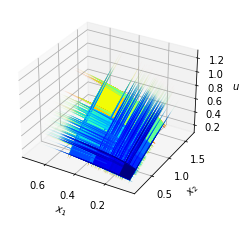

In [162]:
from matplotlib import cm # for colormaps

# a. actual plot
fig = plt.figure()
ax = fig.add_subplot(1,2,1,projection='3d')
ax.plot_surface(h_grid,c_grid,u_grid,cmap=cm.jet)

# b. add labels
ax.set_xlabel('$x_1$')
ax.set_ylabel('$x_2$')
ax.set_zlabel('$u$')

# c. invert xaxis to bring Origin in center front
ax.invert_xaxis()
# d. save
fig.tight_layout()
fig.savefig('someplot.pdf') # or e.g. .png 

ADD ANSWER.

In [ ]:
# code

# Question 3

ADD ANSWER.

In [ ]:
# code

# Question 4

ADD ANSWER.

In [ ]:
# code
mp['epsl']=0.8
mp['tau_g']=0.01
mp['tau_p']=0.009
mp['p_bar']=8 


# Question 5

ADD ANSWER.

In [ ]:
# code

# Conclusion

ADD CONCISE CONLUSION.